## Reading the python file 

In [2]:
import pandas as pd 

In [3]:
import numpy as np

In [4]:
import matplotlib.pyplot as plt

In [5]:
import seaborn as sns

In [6]:
import scipy.stats as stats

In [7]:
from sklearn.svm import SVC

In [8]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix , precision_score, recall_score

In [9]:
from sklearn.preprocessing import StandardScaler

In [10]:
from sklearn.metrics import roc_curve, auc

In [11]:
from sklearn.linear_model import LogisticRegression

In [12]:
from sklearn.neighbors import KNeighborsClassifier

## Data Loading 

In [56]:
df=pd.read_csv(r'C:\Users\ts280\Documents\GitHub\pythonprograms\data.csv')

In [58]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [60]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [61]:
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [62]:
df = df.drop(columns=["id", "Unnamed: 32"], errors="ignore")

In [63]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [64]:
df.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [65]:
df.shape

(569, 31)

In [66]:
df['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [67]:
print(df.isnull().sum())

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64


## EDA

C:\Users\ts280\AppData\Local\Temp\ipykernel_10204\3285625932.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=df["diagnosis"], palette="coolwarm")


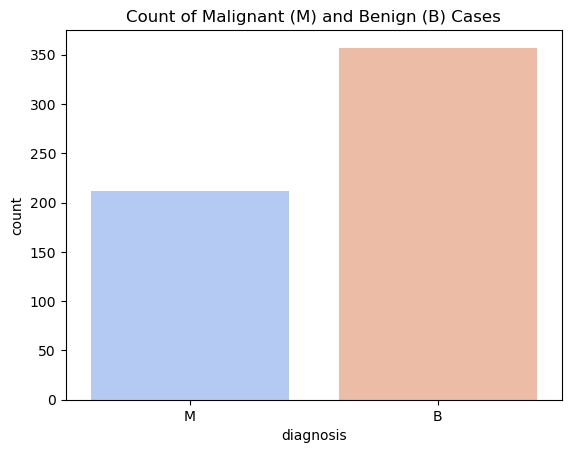

In [69]:
# Count of target variable (Malignant vs. Benign)
sns.countplot(x=df["diagnosis"], palette="coolwarm")
plt.title("Count of Malignant (M) and Benign (B) Cases")
plt.show()

# Histogram

IndexError: index 30 is out of bounds for axis 0 with size 30

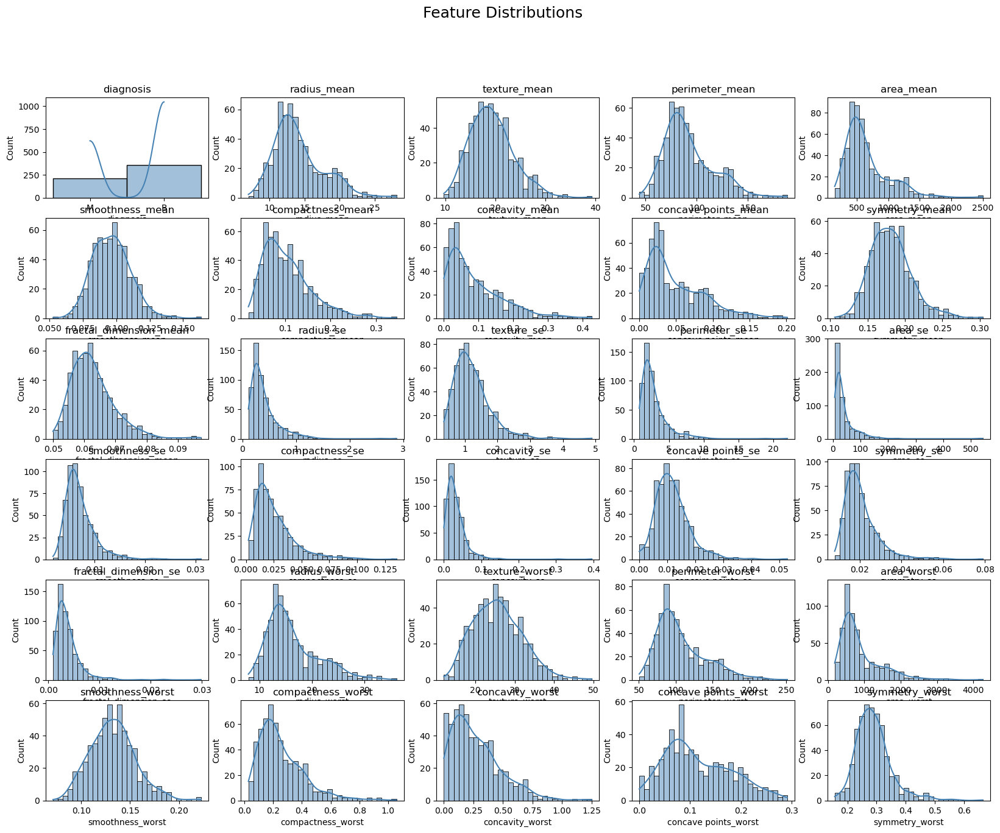

In [71]:
num_features = len(df.columns)

# Set up subplots (adjust rows & cols for better spacing)
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(20, 15))  # Adjust grid based on your feature count
fig.suptitle("Feature Distributions", fontsize=18)

# Flatten axes array for easy iteration
axes = axes.flatten()

# Plot each feature in a separate subplot
for i, col in enumerate(df.columns):
    sns.histplot(df[col], bins=30, kde=True, ax=axes[i], color="steelblue")
    axes[i].set_title(col)

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

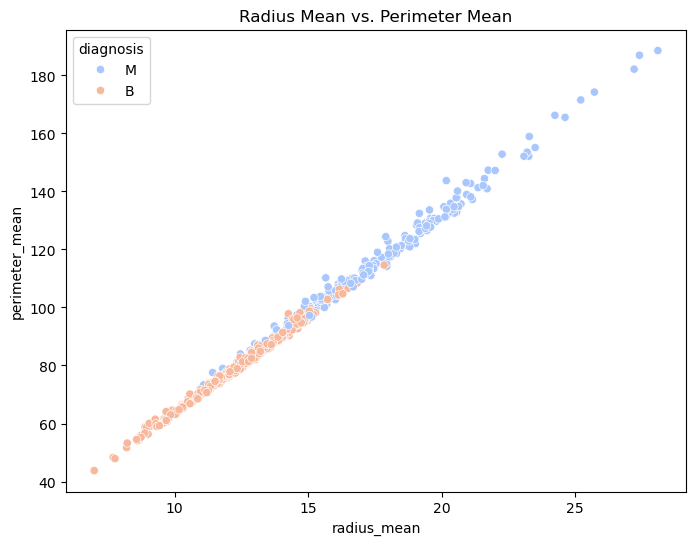

In [93]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x=df["radius_mean"], y=df["perimeter_mean"], hue=df["diagnosis"], palette="coolwarm")
plt.title("Radius Mean vs. Perimeter Mean")
plt.show()

In [94]:
sns.pairplot(df, hue="diagnosis", diag_kind="kde", palette="coolwarm")
plt.show()

## Heatmap

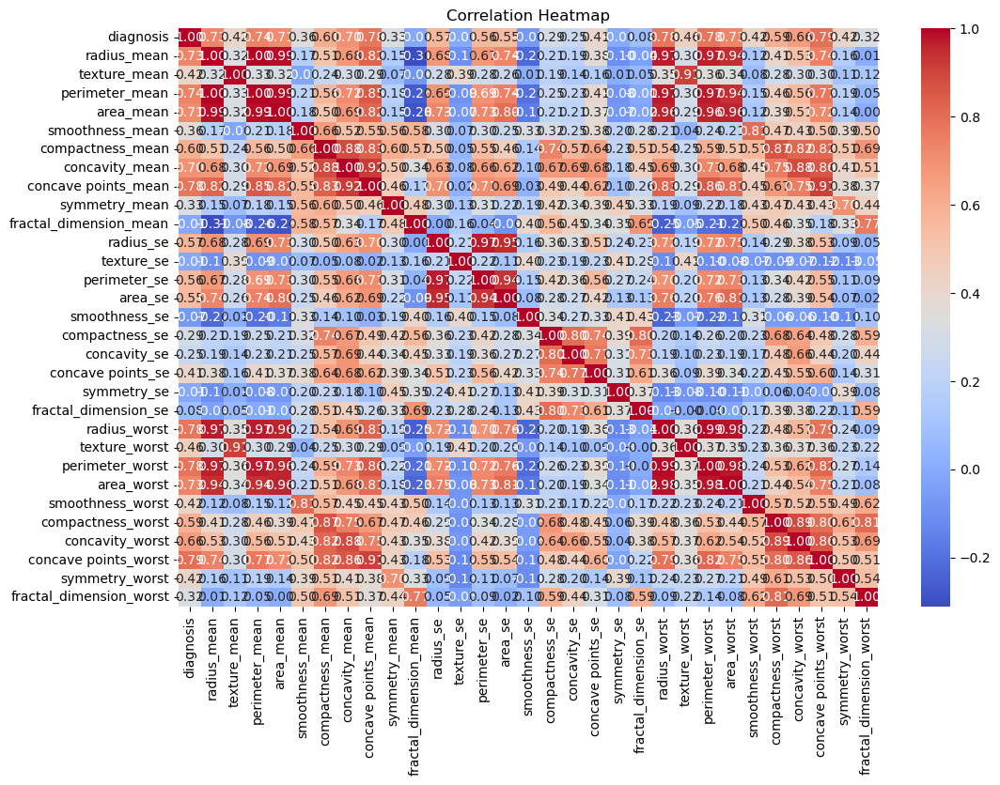

In [96]:
# Convert 'diagnosis' to numeric if not already done
df["diagnosis"] = df["diagnosis"].map({"M": 1, "B": 0})

# Compute correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

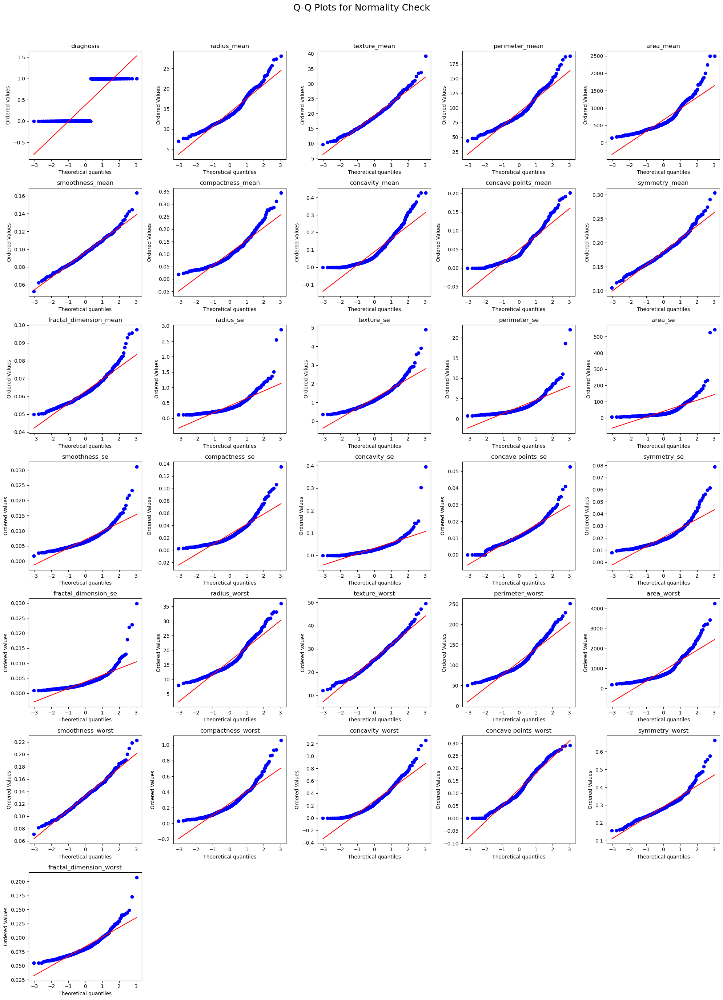

In [97]:
numeric_features = df.select_dtypes(include=["number"]).columns
num_features = len(numeric_features)

# Dynamically determine grid size
rows = int(np.ceil(num_features / 5))  # 5 plots per row
cols = min(5, num_features)  # Max 5 columns, but limit based on features

# Create subplots
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(20, 4 * rows))  
fig.suptitle("Q-Q Plots for Normality Check", fontsize=18)

# Flatten axes array for iteration
axes = np.array(axes).flatten()  

# Plot Q-Q plots for each numeric feature
for i, col in enumerate(numeric_features):
    stats.probplot(df[col], dist="norm", plot=axes[i])
    axes[i].set_title(col)

# Hide unused subplots (if any)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

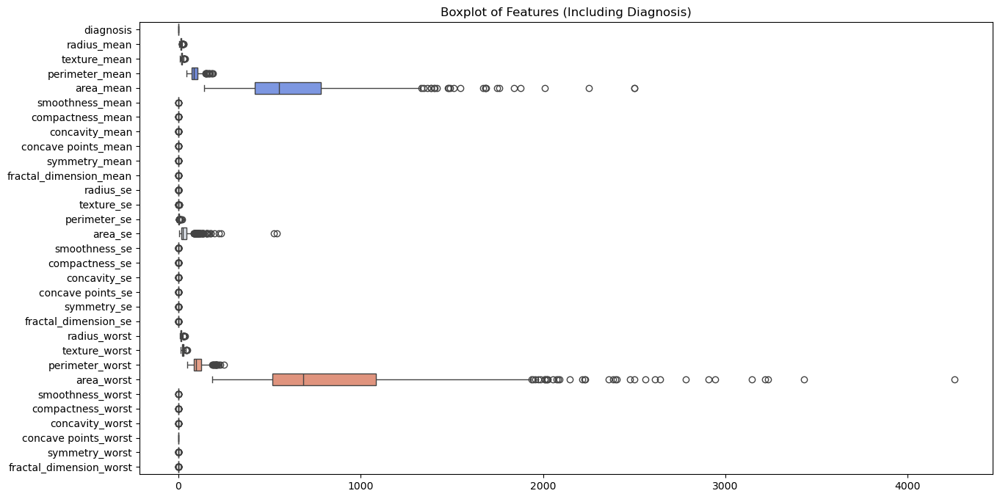

In [98]:
plt.figure(figsize=(15, 8))
sns.boxplot(data=df, orient="h", palette="coolwarm")
plt.title("Boxplot of Features (Including Diagnosis)")
plt.show()

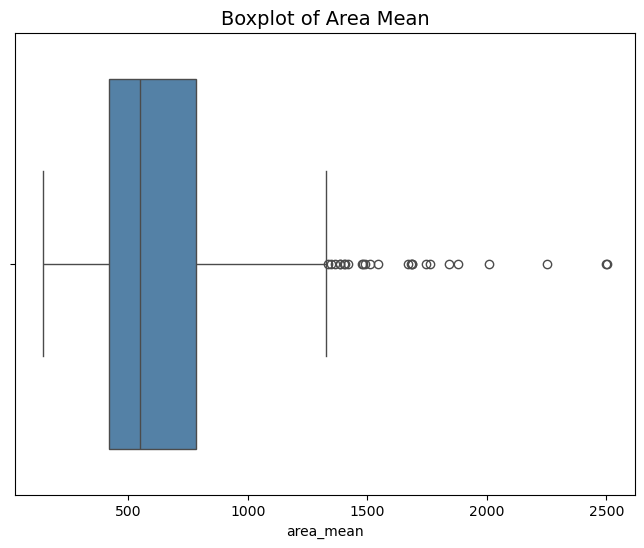

In [99]:
plt.figure(figsize=(8, 6))

# Create a boxplot for 'perimeter_mean'
sns.boxplot(x=df["area_mean"], color="steelblue")

# Add title
plt.title("Boxplot of Area Mean", fontsize=14)

# Show the plot
plt.show()


In [100]:
Q1 = df["area_mean"].quantile(0.25)
Q3 = df["area_mean"].quantile(0.75)
IQR = Q3 - Q1

# Define lower and upper bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Remove outliers and update new_df
new_df = df[(df["area_mean"] >= lower_bound) & (df["area_mean"] <= upper_bound)].copy()

# Print dataset shape before and after processing
print(f"Original Dataset Shape: {df.shape}")
print(f"Processed Dataset Shape (After Removing Outliers from area_mean): {new_df.shape}")


Original Dataset Shape: (569, 31)
Processed Dataset Shape (After Removing Outliers from area_mean): (544, 31)


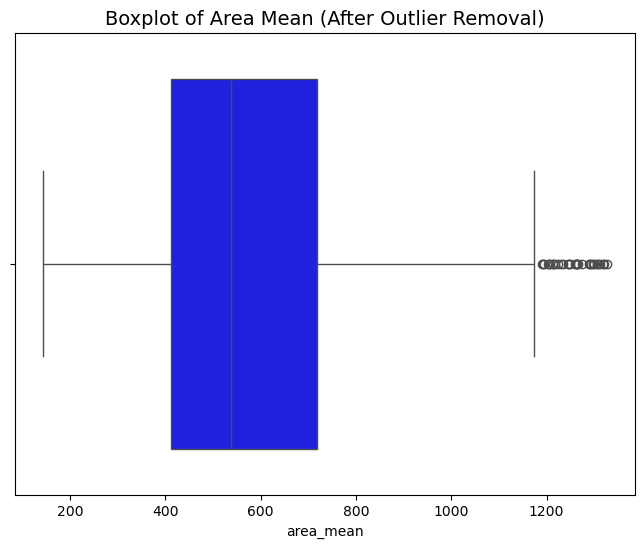

In [101]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set figure size
plt.figure(figsize=(8, 6))

# Create a boxplot for 'area_mean' in the cleaned dataset
sns.boxplot(x=new_df["area_mean"], color="blue")

# Add title
plt.title("Boxplot of Area Mean (After Outlier Removal)", fontsize=14)

# Show the plot
plt.show()

In [102]:
# Compute Q1, Q3, and IQR for 'area_worst'
Q1 = new_df["area_worst"].quantile(0.25)
Q3 = new_df["area_worst"].quantile(0.75)
IQR = Q3 - Q1

# Define lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Remove outliers and update new_df2
new_df2 = new_df[(new_df["area_worst"] >= lower_bound) & (new_df["area_worst"] <= upper_bound)].copy()

# Print dataset shape before and after processing
print(f"Original Dataset Shape: {new_df.shape}")
print(f"Processed Dataset Shape (After Removing Outliers from area_worst): {new_df2.shape}")


Original Dataset Shape: (544, 31)
Processed Dataset Shape (After Removing Outliers from area_worst): (509, 31)


In [103]:
new_df2.shape

(509, 31)

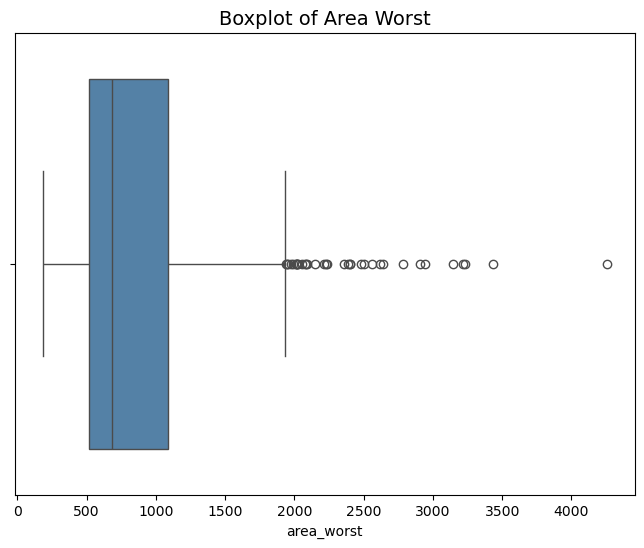

In [104]:
plt.figure(figsize=(8, 6))

# Create a boxplot for 'perimeter_mean'
sns.boxplot(x=df["area_worst"], color="steelblue")

# Add title
plt.title("Boxplot of Area Worst", fontsize=14)

# Show the plot
plt.show()

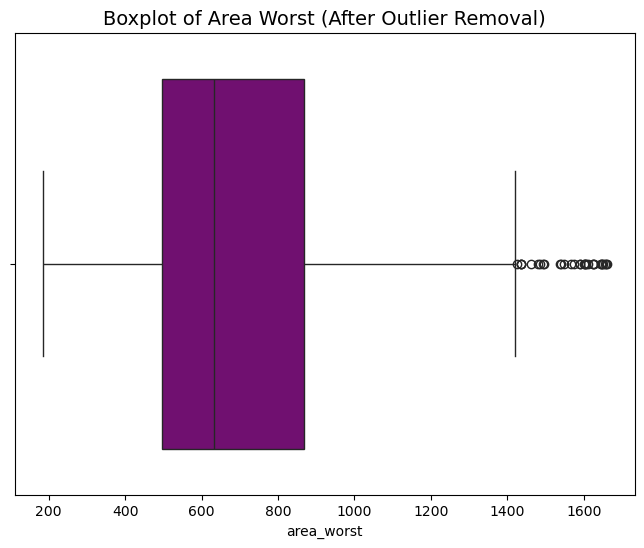

In [105]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set figure size
plt.figure(figsize=(8, 6))

# Create a boxplot for 'area_worst' in the cleaned dataset
sns.boxplot(x=new_df2["area_worst"], color="purple")

# Add title
plt.title("Boxplot of Area Worst (After Outlier Removal)", fontsize=14)

# Show the plot
plt.show()


In [106]:
new_df2.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [107]:
x = new_df2.drop(columns=["diagnosis"]) # Feature variables

In [108]:
y = new_df2["diagnosis"]  # Target variable

## Get Train Test Split

In [110]:
from sklearn.model_selection import train_test_split

In [111]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.3,stratify=y, random_state=2523)

In [112]:
x_train.shape, x_test.shape , y_train.shape, y_test.shape

((356, 30), (153, 30), (356,), (153,))

## Get Model Train

In [114]:
rf = RandomForestClassifier(n_estimators=100, random_state=42)  # 100 Trees

In [115]:
rf.fit(x_train, y_train)

RandomForestClassifier(random_state=42)

In [116]:
pred = rf.predict(x_test)

In [117]:
accuracy = accuracy_score(y_test, pred)
print(f"Accuracy: {accuracy:.4f}")

print("\nClassification Report:")
print(classification_report(y_test, pred))

Accuracy: 0.9673

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.98       107
           1       0.96      0.93      0.95        46

    accuracy                           0.97       153
   macro avg       0.96      0.96      0.96       153
weighted avg       0.97      0.97      0.97       153



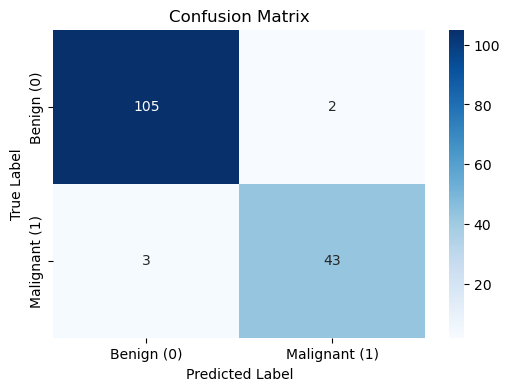

In [118]:
cm = confusion_matrix(y_test, pred)

# Plot confusion matrix as a heatmap
plt.figure(figsize=(6,4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Benign (0)", "Malignant (1)"], yticklabels=["Benign (0)", "Malignant (1)"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

## SVC Classifier Model 

In [120]:
svc_model = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
svc_model.fit(x_train, y_train)
y_pred = svc_model.predict(x_test)

In [121]:
accuracy_svc = accuracy_score(y_test, y_pred)
print(f"Accuracy (SVC): {accuracy_svc:.4f}")

print("\nClassification Report (SVC):")
print(classification_report(y_test, y_pred))

Accuracy (SVC): 0.9020

Classification Report (SVC):
              precision    recall  f1-score   support

           0       0.90      0.96      0.93       107
           1       0.90      0.76      0.82        46

    accuracy                           0.90       153
   macro avg       0.90      0.86      0.88       153
weighted avg       0.90      0.90      0.90       153



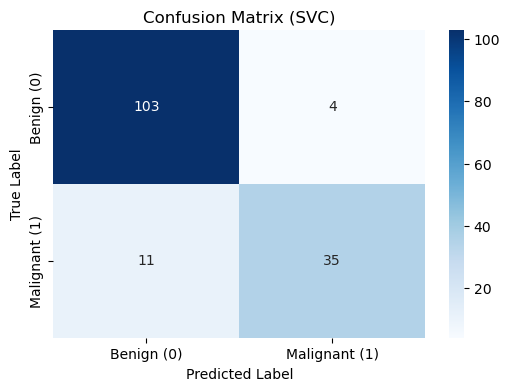

In [122]:
cm_svc = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(6,4))
sns.heatmap(cm_svc, annot=True, fmt="d", cmap="Blues", xticklabels=["Benign (0)", "Malignant (1)"], yticklabels=["Benign (0)", "Malignant (1)"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix (SVC)")
plt.show()

## LR Algogrithm

In [124]:
# Standardizing the features for better model performance
scaler = StandardScaler()
X_train = scaler.fit_transform(x_train)
X_test = scaler.transform(x_test)

In [125]:
lr = LogisticRegression()
lr.fit(X_train, y_train)

# Make predictions
Y_pred = lr.predict(X_test)

In [126]:
accuracy_lr = accuracy_score(y_test,Y_pred)
print(f"Accuracy: {accuracy:.4f}")

Accuracy: 0.9673


In [127]:
print("\nClassification Report (LR):")
print(classification_report(y_test, Y_pred))


Classification Report (LR):
              precision    recall  f1-score   support

           0       0.98      0.98      0.98       107
           1       0.96      0.96      0.96        46

    accuracy                           0.97       153
   macro avg       0.97      0.97      0.97       153
weighted avg       0.97      0.97      0.97       153



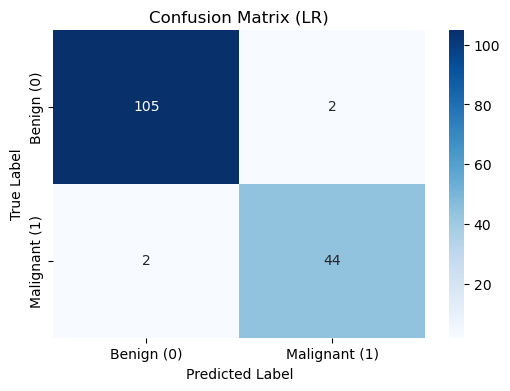

In [128]:
cm_lr = confusion_matrix(y_test, Y_pred)

plt.figure(figsize=(6,4))
sns.heatmap(cm_lr, annot=True, fmt="d", cmap="Blues", xticklabels=["Benign (0)", "Malignant (1)"], yticklabels=["Benign (0)", "Malignant (1)"])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix (LR)")
plt.show()

In [129]:
# Initialize KNN with k=5 (default)
knn = KNeighborsClassifier(n_neighbors=5)

# Train the model
knn.fit(X_train, y_train)

# Make predictions
y_pred_KNN = knn.predict(X_test)

In [130]:
accuracy = accuracy_score(y_test, y_pred_KNN)
print(f"Model Accuracy: {accuracy:.4f}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred_KNN)
print("Confusion Matrix:\n", cm)

# Classification Report
print("Classification Report:\n", classification_report(y_test, y_pred_KNN))

Model Accuracy: 0.9739
Confusion Matrix:
 [[107   0]
 [  4  42]]
Classification Report:
               precision    recall  f1-score   support

           0       0.96      1.00      0.98       107
           1       1.00      0.91      0.95        46

    accuracy                           0.97       153
   macro avg       0.98      0.96      0.97       153
weighted avg       0.97      0.97      0.97       153



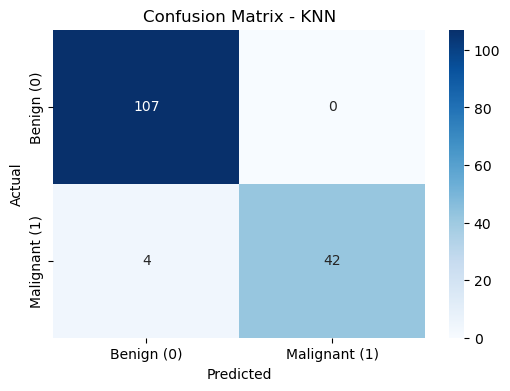

In [131]:
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Benign (0)', 'Malignant (1)'],
            yticklabels=['Benign (0)', 'Malignant (1)'])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix - KNN")
plt.show()

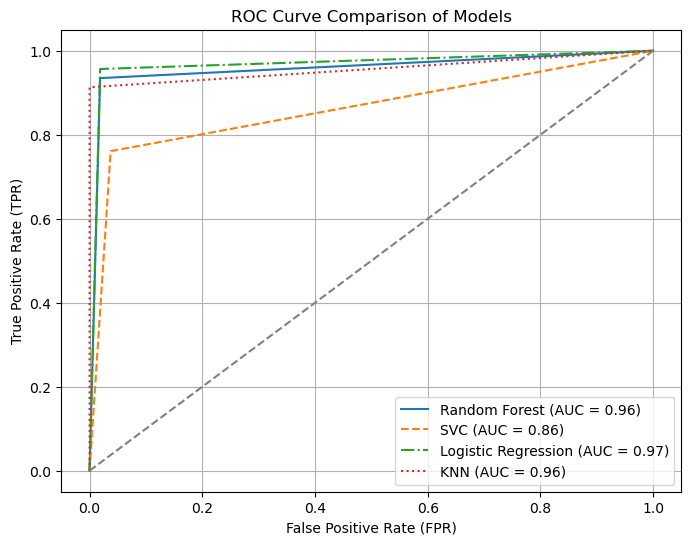

In [132]:
# Compute ROC Curves
fpr_rf, tpr_rf, _ = roc_curve(y_test, pred)  # Random Forest
fpr_svc, tpr_svc, _ = roc_curve(y_test, y_pred)  # SVC
fpr_lr, tpr_lr, _ = roc_curve(y_test, Y_pred)  # Logistic Regression
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_pred_KNN)  # KNN

# Compute AUC Scores
auc_rf = auc(fpr_rf, tpr_rf)
auc_svc = auc(fpr_svc, tpr_svc)
auc_lr = auc(fpr_lr, tpr_lr)
auc_knn = auc(fpr_knn, tpr_knn)

# Plot ROC Curve
plt.figure(figsize=(8, 6))

plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC = {auc_rf:.2f})", linestyle="-")
plt.plot(fpr_svc, tpr_svc, label=f"SVC (AUC = {auc_svc:.2f})", linestyle="--")
plt.plot(fpr_lr, tpr_lr, label=f"Logistic Regression (AUC = {auc_lr:.2f})", linestyle="-.")
plt.plot(fpr_knn, tpr_knn, label=f"KNN (AUC = {auc_knn:.2f})", linestyle=":")

# Plot baseline (random guessing)
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")

# Customize plot
plt.xlabel("False Positive Rate (FPR)")
plt.ylabel("True Positive Rate (TPR)")
plt.title("ROC Curve Comparison of Models")
plt.legend()
plt.grid()
plt.show()

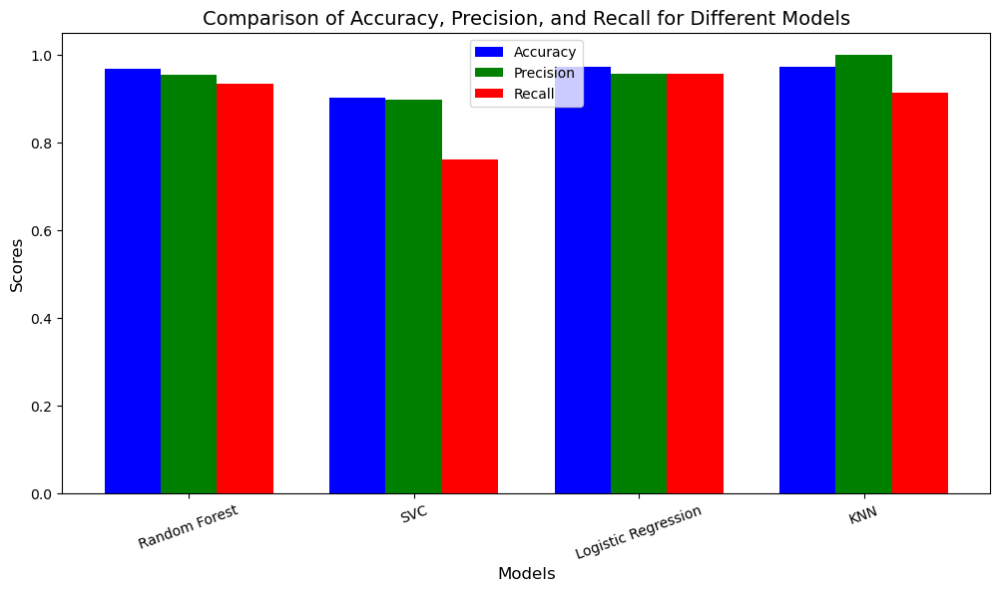

In [133]:
# Dictionary to store performance metrics
metrics = {
    "Random Forest": {
        "Accuracy": accuracy_score(y_test, pred),
        "Precision": precision_score(y_test, pred, average="binary"),
        "Recall": recall_score(y_test, pred, average="binary")
    },
    "SVC": {
        "Accuracy": accuracy_score(y_test, y_pred),
        "Precision": precision_score(y_test, y_pred, average="binary"),
        "Recall": recall_score(y_test, y_pred, average="binary")
    },
    "Logistic Regression": {
        "Accuracy": accuracy_score(y_test, Y_pred),
        "Precision": precision_score(y_test, Y_pred, average="binary"),
        "Recall": recall_score(y_test, Y_pred, average="binary")
    },
    "KNN": {
        "Accuracy": accuracy_score(y_test, y_pred_KNN),
        "Precision": precision_score(y_test, y_pred_KNN, average="binary"),
        "Recall": recall_score(y_test, y_pred_KNN, average="binary")
    }
}

# Convert dictionary to structured lists
models = list(metrics.keys())
accuracy = [metrics[m]["Accuracy"] for m in models]
precision = [metrics[m]["Precision"] for m in models]
recall = [metrics[m]["Recall"] for m in models]

# Bar width
bar_width = 0.25
x_indexes = np.arange(len(models))

# Plot the bar chart
plt.figure(figsize=(12, 6))
plt.bar(x_indexes, accuracy, width=bar_width, label="Accuracy", color="b")
plt.bar(x_indexes + bar_width, precision, width=bar_width, label="Precision", color="g")
plt.bar(x_indexes + 2 * bar_width, recall, width=bar_width, label="Recall", color="r")

# Labels and title
plt.xlabel("Models", fontsize=12)
plt.ylabel("Scores", fontsize=12)
plt.title("Comparison of Accuracy, Precision, and Recall for Different Models", fontsize=14)
plt.xticks(ticks=x_indexes + bar_width, labels=models, rotation=20)
plt.legend()
plt.show()